In [1]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, davies_bouldin_score, homogeneity_score
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sentence_transformers import SentenceTransformer
from wordcloud import WordCloud
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv("..\\..\\data\\words\\processed_words_set_from_the_supervisor.csv", encoding='windows-1251')
df

,DocumentName,Word,NormalizedWord,FrequencyInText,FrequencyInCorpus,PartOfSpeech
0,VoenObozren2016_2019_1_0367.t,в,в,85,19397,F
1,VoenObozren2016_2019_1_0366.t,в,в,23,19397,F
2,VoenObozren2016_2019_1_0365.t,в,в,51,19397,F
3,VoenObozren2016_2019_1_0364.t,в,в,59,19397,F
4,VoenObozren2016_2019_1_0363.t,в,в,43,19397,F
...,...,...,...,...,...,...
207078,VoenObozren2016_2019_1_0001.t,калечащих,калечащий,1,1,A
207079,VoenObozren2016_2019_1_0001.t,заточка-пилка,заточка-пилка,1,1,N
207080,VoenObozren2016_2019_1_0001.t,зарослей,заросль,1,1,N
207081,VoenObozren2016_2019_1_0001.t,выручали,выручал,1,1,L


In [3]:
meaningless_pos = {'0', '&', 'F', 'e', 's', 'm', 'M', 'Y', 'n'}
df = df[~df['PartOfSpeech'].isin(meaningless_pos)]

meaningless_words = {
    'быть', 'был', 'есть', 'будет', 'может', 'мочь', 'являться',
    'имеющий', 'имеющая', 'имеющее', 'имеющие',
    'идущий', 'идущая', 'идущие', 'идущего',
    'он', 'я', 'сам', 'сама', 'само', 'сами', 'тот', 'та', 'то', 'те',
    'такой', 'такая', 'такое', 'такие', 'данный', 'данная', 'данное', 'данные',
    'чего', 'почему', 'зачем', 'где', 'когда', 'пока',
    'уже', 'еще', 'сейчас', 'теперь', 'тогда',
    'должен', 'должна', 'должно', 'должны',
    'человек', 'люди', 'раз', 'мир', 'время', 'год',
    'прошлый', 'следующий', 'новый', 'старый', 'большой', 'маленький',
    'который', 'которая', 'которое', 'которые',
    'поэтому'
}
df = df[~df['NormalizedWord'].isin(meaningless_words)]
df = df.copy()
df['FrequencyInText'] = df['FrequencyInText'].astype(int)
df['FrequencyInCorpus'] = df['FrequencyInCorpus'].astype(int)

filtered_df = df[(df['FrequencyInCorpus'] > 1) & (df['FrequencyInText'] > 1)]
filtered_df

,DocumentName,Word,NormalizedWord,FrequencyInText,FrequencyInCorpus,PartOfSpeech
5956,VoenObozren2016_2019_1_0364.t,ракеты,ракета,37,2217,N
5957,VoenObozren2016_2019_1_0362.t,ракет,ракета,2,2217,N
5959,VoenObozren2016_2019_1_0353.t,ракет,ракета,3,2217,N
5962,VoenObozren2016_2019_1_0346.t,ракетами,ракета,2,2217,N
5963,VoenObozren2016_2019_1_0345.t,ракеты,ракета,17,2217,N
...,...,...,...,...,...,...
198152,VoenObozren2016_2019_1_0004.t,плащ-палатка,плащ-палатка,2,2,N
198164,VoenObozren2016_2019_1_0003.t,юнга,юнга,2,2,N
198182,VoenObozren2016_2019_1_0002.t,изготовлять,изготовлять,2,2,I
198187,VoenObozren2016_2019_1_0002.t,Голограммы,голограмма,2,2,N


In [4]:
doc_word_matrix = filtered_df.pivot_table(
    index='DocumentName',
    columns='NormalizedWord',
    values='FrequencyInText',
    aggfunc='sum',
    fill_value=0
)
doc_word_matrix

NormalizedWord,Бронеавтомобиль-бронедрезина,Бугско-Днепровско-лиманского,Бугско-Днепровско-лиманскому,абакан,абдалла,абердинский,абонент,абонентский,абрамович,абрамс,...,ярыгин,ясень,ясень-м,ясный,ястреб,яуза,яхонт,ячейка,ящик,яэу
DocumentName,,,,,,,,,,,,,,,,,,,,,
VoenObozren2016_2019_1_0001.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0002.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0003.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0004.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0005.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VoenObozren2016_2019_1_0363.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0364.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
VoenObozren2016_2019_1_0365.t,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
transformer = TfidfTransformer()
tfidf_matrix = transformer.fit_transform(doc_word_matrix)
similarity_matrix = cosine_similarity(tfidf_matrix)
similarity_df = pd.DataFrame(similarity_matrix, index=doc_word_matrix.index, columns=doc_word_matrix.index)
similarity_df.to_csv("..\\..\\data\\words\\cosine_similarity_matrix.csv", index=True)

In [6]:
def save_clusters(labels, method_name):
    cluster_df = pd.DataFrame({"Document": doc_word_matrix.index, "Cluster": labels})
    cluster_df.to_csv(f"..\\..\\data\\words\\{method_name}_clusters.csv", index=False)

def save_cluster_centers(feature_matrix, labels, method_name):
    unique_clusters = np.unique(labels)
    cluster_centers = []
    for cluster in unique_clusters:
        if cluster == -1:
            continue
        cluster_indices = np.where(labels == cluster)[0]
        cluster_vectors = feature_matrix[cluster_indices]
        # Если feature_matrix – это sparse матрица, приводим к array
        if not isinstance(cluster_vectors, np.ndarray):
            cluster_vectors = cluster_vectors.toarray()
        center_idx = np.argmin(cdist([cluster_vectors.mean(axis=0)], cluster_vectors)[0])
        central_file = doc_word_matrix.index[cluster_indices[center_idx]]
        cluster_centers.append((cluster, central_file))

    centers_df = pd.DataFrame(cluster_centers, columns=["Cluster", "Central_File"])
    centers_df.to_csv(f"..\\..\\data\\words\\{method_name}_cluster_centers.csv", index=False)

In [7]:
k = 30
kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
kmeans_labels = kmeans.fit_predict(tfidf_matrix)
save_clusters(kmeans_labels, "kmeans")
save_cluster_centers(tfidf_matrix, kmeans_labels, "kmeans")

eps = 0.6
min_samples = 5
dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="cosine")
dbscan_labels = dbscan.fit_predict(tfidf_matrix)
save_clusters(dbscan_labels, "dbscan")
save_cluster_centers(tfidf_matrix, dbscan_labels, "dbscan")

n_clusters_agglo = 35
agglo = AgglomerativeClustering(n_clusters=n_clusters_agglo, metric="cosine", linkage="average")
agglo_labels = agglo.fit_predict(tfidf_matrix.toarray())
save_clusters(agglo_labels, "agglomerative")
save_cluster_centers(tfidf_matrix, agglo_labels, "agglomerative")

In [8]:
def load_clusters(file_name):
    return pd.read_csv(file_name)

kmeans_clusters = load_clusters("..\\..\\data\\words\\kmeans_clusters.csv")
dbscan_clusters = load_clusters("..\\..\\data\\words\\dbscan_clusters.csv")
agglo_clusters = load_clusters("..\\..\\data\\words\\agglomerative_clusters.csv")

kmeans_cluster_centers = load_clusters("..\\..\\data\\words\\kmeans_cluster_centers.csv")
dbscan_cluster_centers = load_clusters("..\\..\\data\\words\\dbscan_cluster_centers.csv")
agglo_cluster_centers = load_clusters("..\\..\\data\\words\\agglomerative_cluster_centers.csv")

In [9]:
def visualize_clusters(labels, feature_matrix, method_name):
    tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000, metric='cosine')
    # Преобразуем в плотный формат, если нужно
    if not isinstance(feature_matrix, np.ndarray):
        feature_matrix_for_tsne = feature_matrix.toarray()
    else:
        feature_matrix_for_tsne = feature_matrix
    tsne_res = tsne.fit_transform(feature_matrix_for_tsne)

    unique_labels = np.unique(labels)
    cmap = ListedColormap(plt.cm.get_cmap('tab20', len(unique_labels)).colors)

    plt.figure(figsize=(12, 8))
    scatter = plt.scatter(tsne_res[:, 0], tsne_res[:, 1], c=labels, cmap=cmap, s=10, alpha=0.9)
    plt.colorbar(scatter, label=f'{method_name} Cluster', ticks=range(len(unique_labels)))
    plt.title(f't-SNE визуализация кластеров {method_name}')
    plt.xlabel('t-SNE измерение 1')
    plt.ylabel('t-SNE измерение 2')
    plt.grid(True)
    plt.show()

    unique_clusters, counts = np.unique(labels, return_counts=True)
    print(f"{method_name} кластеры:", dict(zip(unique_clusters, counts)))

def generate_word_cloud(cluster_label, cluster_df, method_name):
    cluster_files = cluster_df[cluster_df['Cluster'] == cluster_label]['Document']
    print(f"Файлы в кластере {cluster_label} ({method_name}):")
    for f in cluster_files:
        print(f)

    for doc_name in cluster_files:
        doc_data = filtered_df[filtered_df['DocumentName'] == doc_name]
        word_freq = dict(zip(doc_data['NormalizedWord'], doc_data['FrequencyInText']))
        wc = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)
        plt.figure(figsize=(10, 5))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Облако слов для {doc_name}')
        plt.show()

def evaluate_clustering_quality(feature_matrix, labels, method_name):
    unique_labels = np.unique(labels)
    if len(unique_labels) > 1:
        # Если feature_matrix – это sparse матрица, преобразуем в dense
        if not isinstance(feature_matrix, np.ndarray):
            feature_matrix_eval = feature_matrix.toarray()
        else:
            feature_matrix_eval = feature_matrix
        silhouette = silhouette_score(feature_matrix_eval, labels, metric='cosine')
        davies_bouldin = davies_bouldin_score(feature_matrix_eval, labels)
        # Предполагаем, что true_labels нет, поэтому homogeneity может быть None
        homogeneity = None
    else:
        silhouette, davies_bouldin, homogeneity = None, None, None
    
    print(f"Метрики качества для {method_name}:")
    print(f"  - Силуэтный коэффициент: {silhouette}")
    print(f"  - Коэффициент Давиеса-Боулдина: {davies_bouldin}")
    if homogeneity is not None:
        print(f"  - Гомогенность: {homogeneity}")

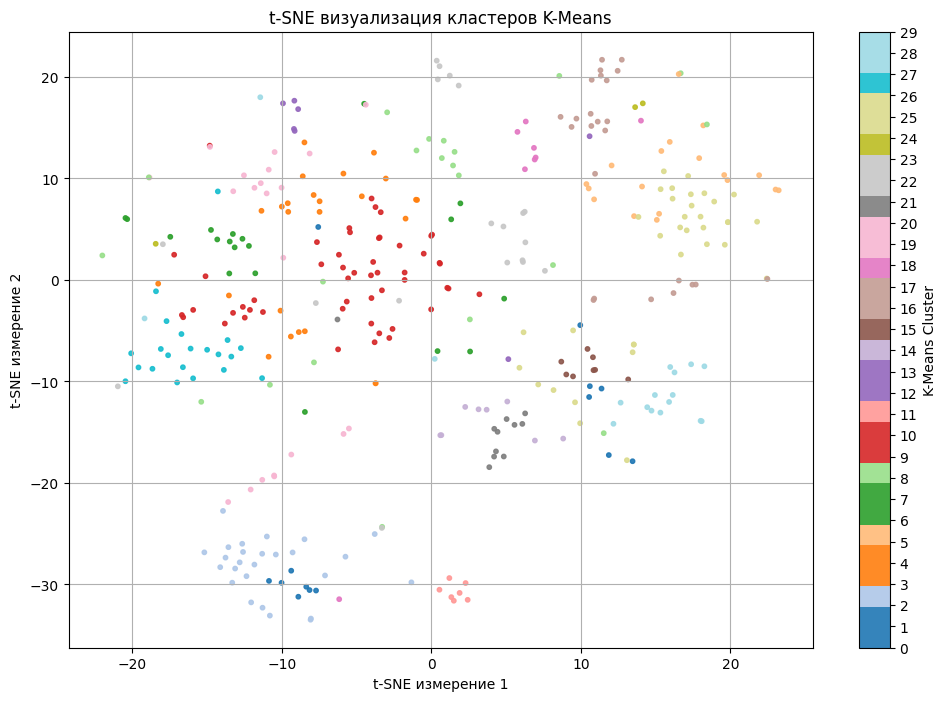

K-Means кластеры: {0: 7, 1: 7, 2: 26, 3: 7, 4: 17, 5: 19, 6: 9, 7: 10, 8: 21, 9: 10, 10: 41, 11: 7, 12: 1, 13: 6, 14: 8, 15: 8, 16: 6, 17: 18, 18: 8, 19: 7, 20: 14, 21: 11, 22: 12, 23: 7, 24: 3, 25: 24, 26: 11, 27: 21, 28: 12, 29: 5}
Файлы в кластере 9 (K-Means):
VoenObozren2016_2019_1_0095.t
VoenObozren2016_2019_1_0097.t
VoenObozren2016_2019_1_0098.t
VoenObozren2016_2019_1_0099.t
VoenObozren2016_2019_1_0101.t
VoenObozren2016_2019_1_0106.t
VoenObozren2016_2019_1_0213.t
VoenObozren2016_2019_1_0214.t
VoenObozren2016_2019_1_0215.t
VoenObozren2016_2019_1_0323.t


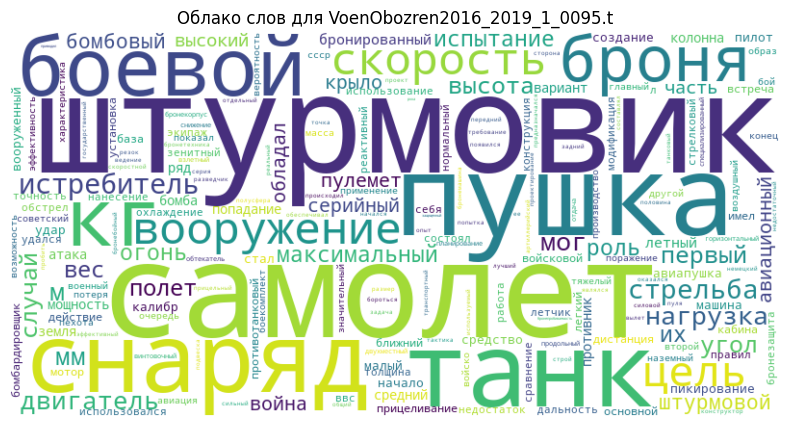

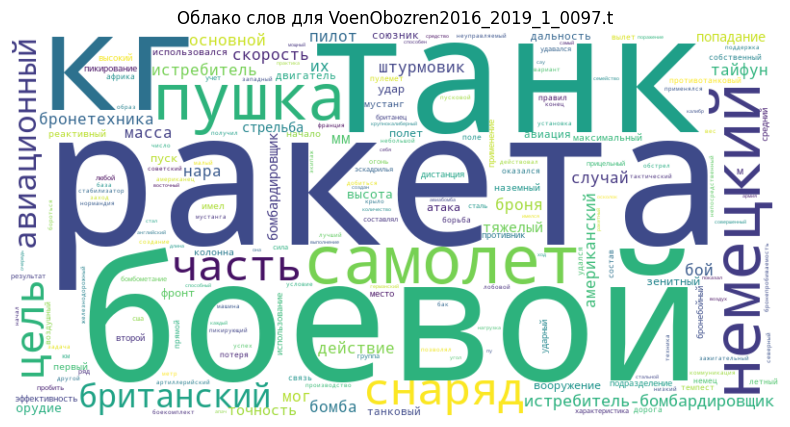

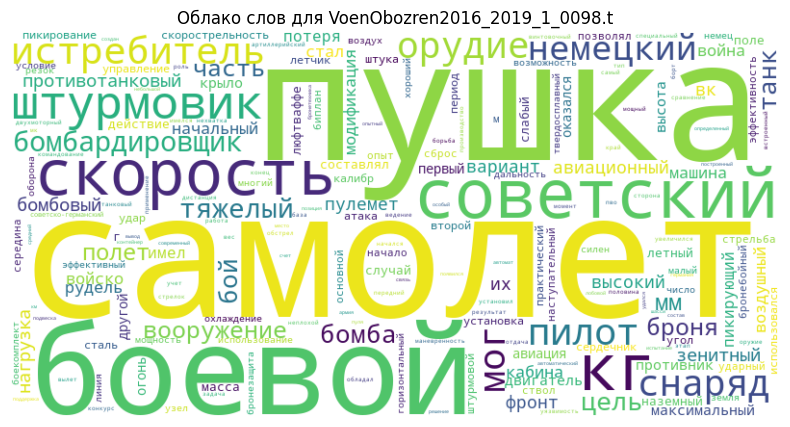

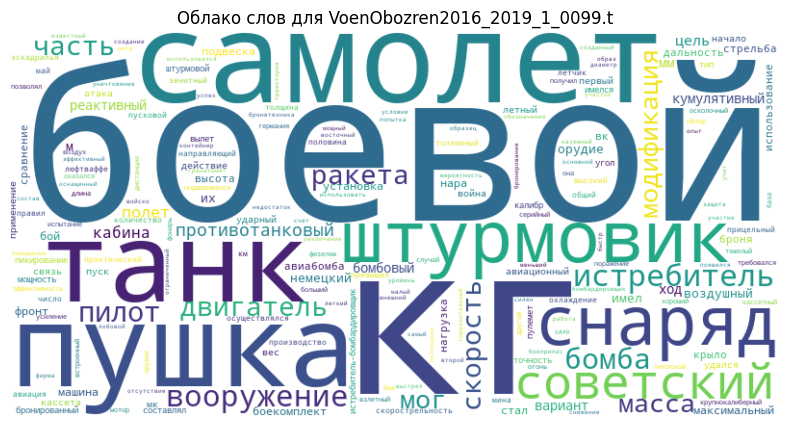

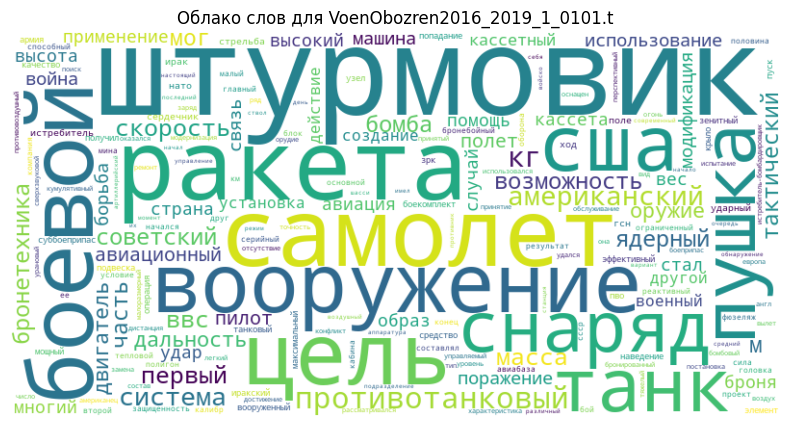

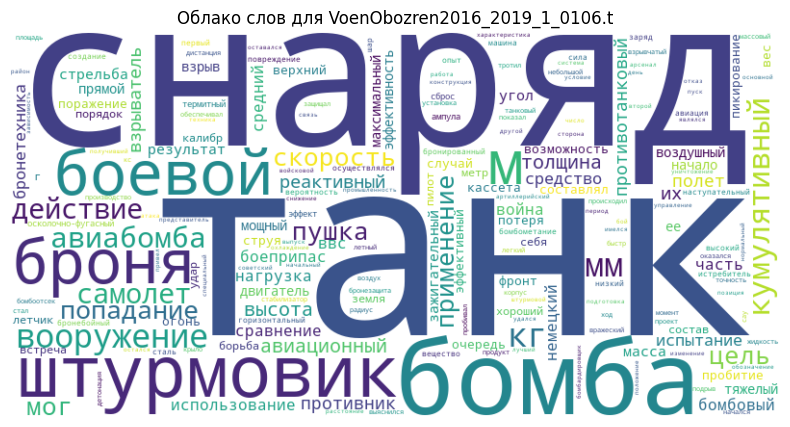

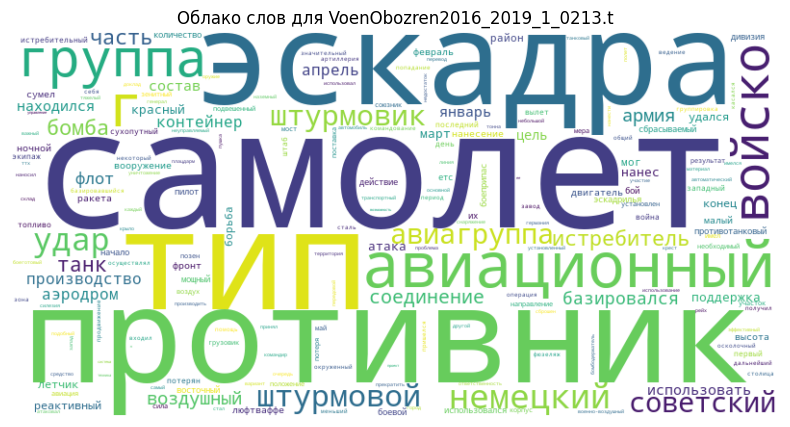

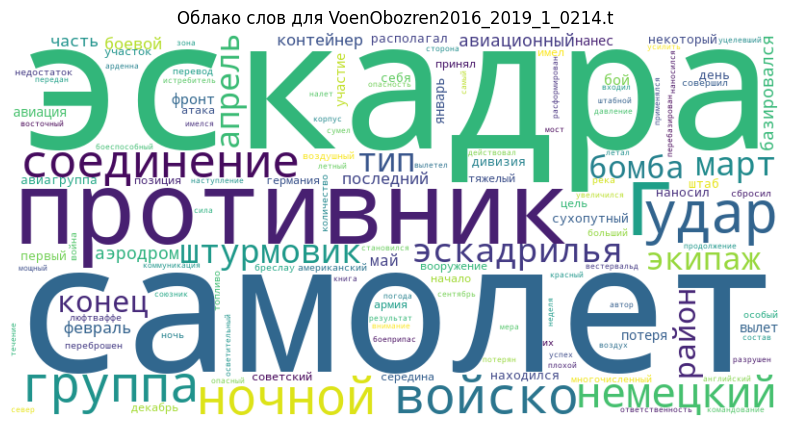

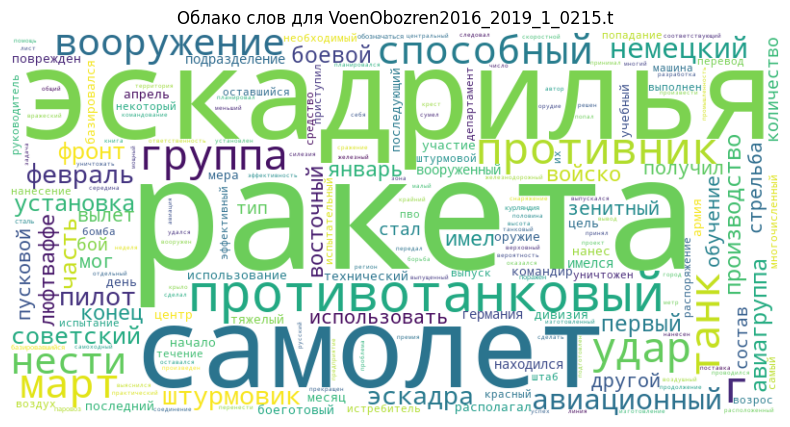

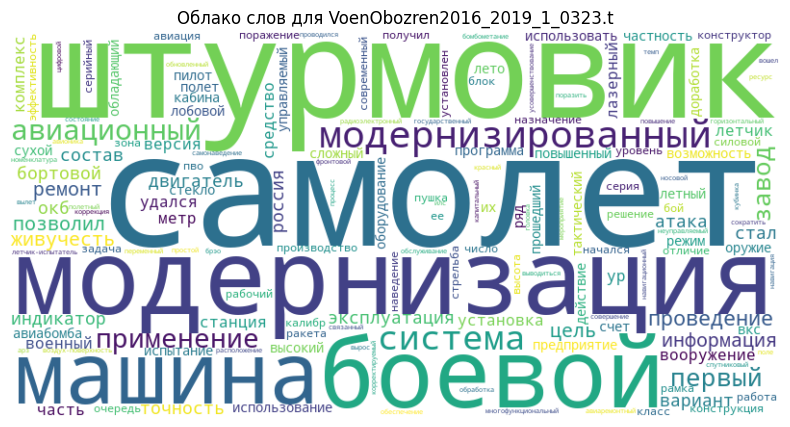

                          Document  Cluster
0    VoenObozren2016_2019_1_0001.t        8
1    VoenObozren2016_2019_1_0002.t       22
2    VoenObozren2016_2019_1_0003.t       26
3    VoenObozren2016_2019_1_0004.t        2
4    VoenObozren2016_2019_1_0005.t       27
..                             ...      ...
358  VoenObozren2016_2019_1_0363.t       14
359  VoenObozren2016_2019_1_0364.t       10
360  VoenObozren2016_2019_1_0365.t       11
361  VoenObozren2016_2019_1_0366.t       11
362  VoenObozren2016_2019_1_0367.t       11

[363 rows x 2 columns]
    Cluster                   Central_File
0         0  VoenObozren2016_2019_1_0337.t
1         1  VoenObozren2016_2019_1_0118.t
2         2  VoenObozren2016_2019_1_0222.t
3         3  VoenObozren2016_2019_1_0077.t
4         4  VoenObozren2016_2019_1_0279.t
5         5  VoenObozren2016_2019_1_0292.t
6         6  VoenObozren2016_2019_1_0105.t
7         7  VoenObozren2016_2019_1_0059.t
8         8  VoenObozren2016_2019_1_0033.t
9         9  VoenO

In [10]:
visualize_clusters(kmeans_clusters['Cluster'].values, tfidf_matrix, "K-Means")
generate_word_cloud(9, kmeans_clusters, "K-Means")
print(kmeans_clusters)
print(kmeans_cluster_centers)
evaluate_clustering_quality(tfidf_matrix, kmeans_labels, "K-Means")

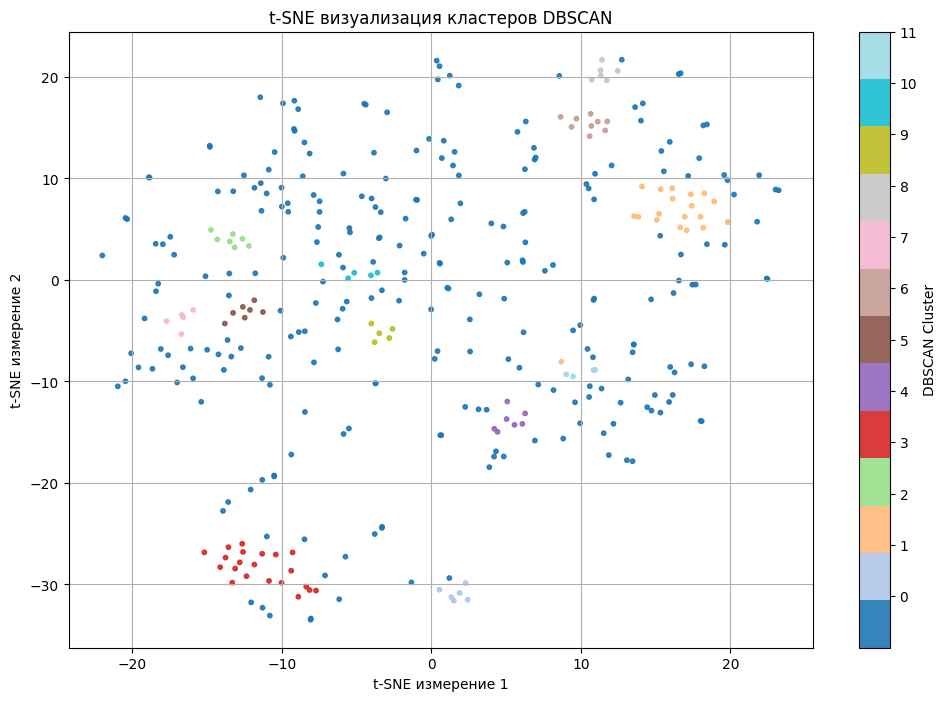

DBSCAN кластеры: {-1: 261, 0: 6, 1: 20, 2: 7, 3: 21, 4: 7, 5: 7, 6: 9, 7: 5, 8: 6, 9: 5, 10: 5, 11: 4}
Файлы в кластере 5 (DBSCAN):
VoenObozren2016_2019_1_0095.t
VoenObozren2016_2019_1_0097.t
VoenObozren2016_2019_1_0098.t
VoenObozren2016_2019_1_0099.t
VoenObozren2016_2019_1_0101.t
VoenObozren2016_2019_1_0106.t
VoenObozren2016_2019_1_0323.t


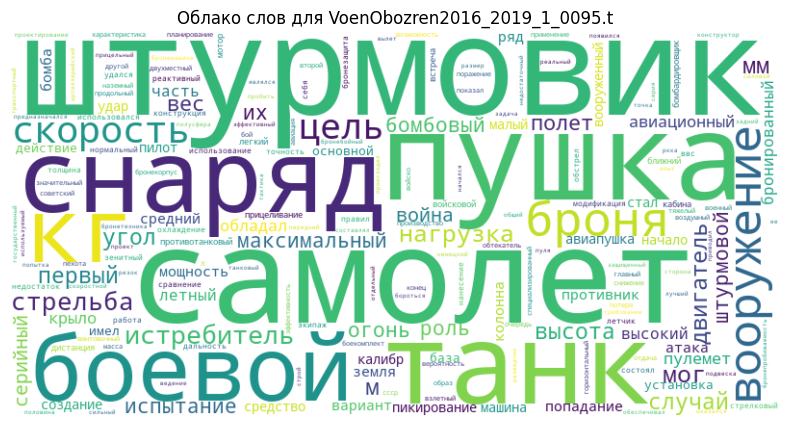

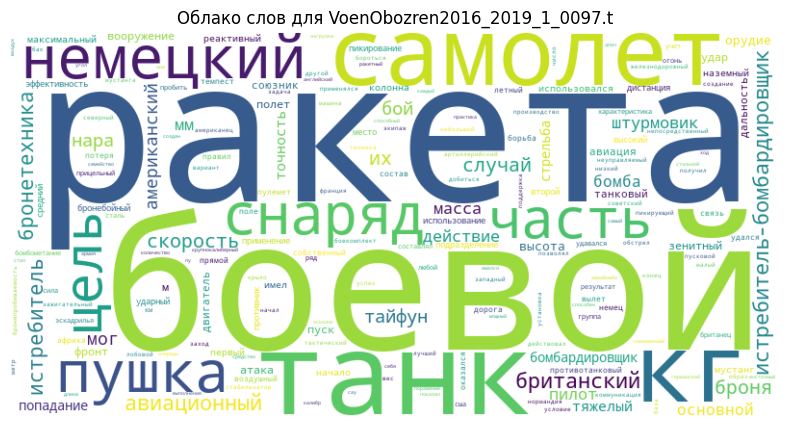

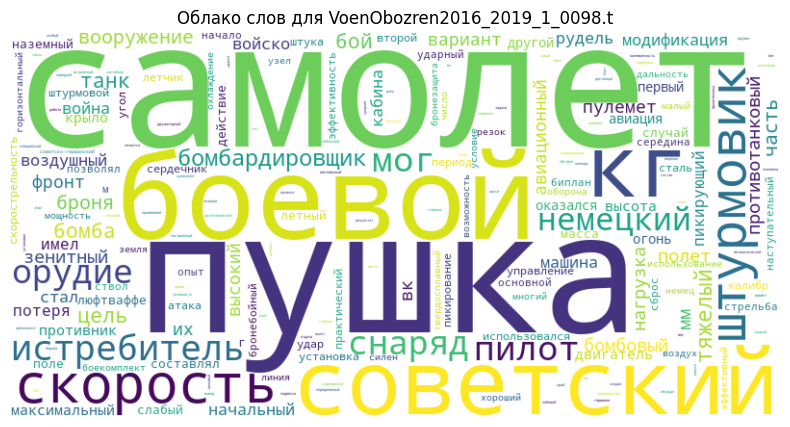

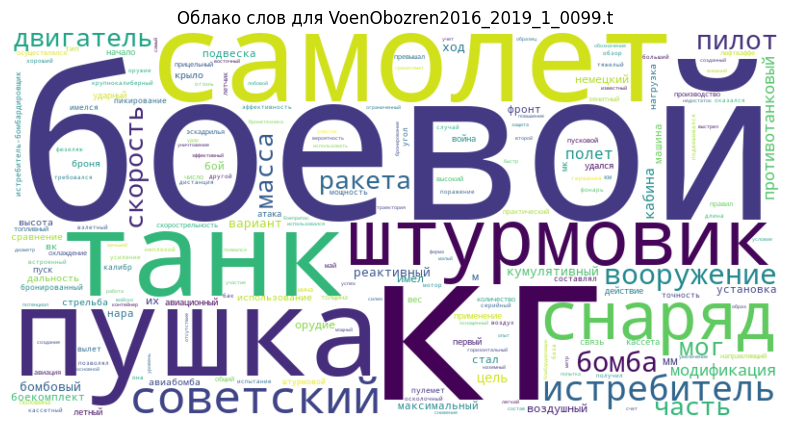

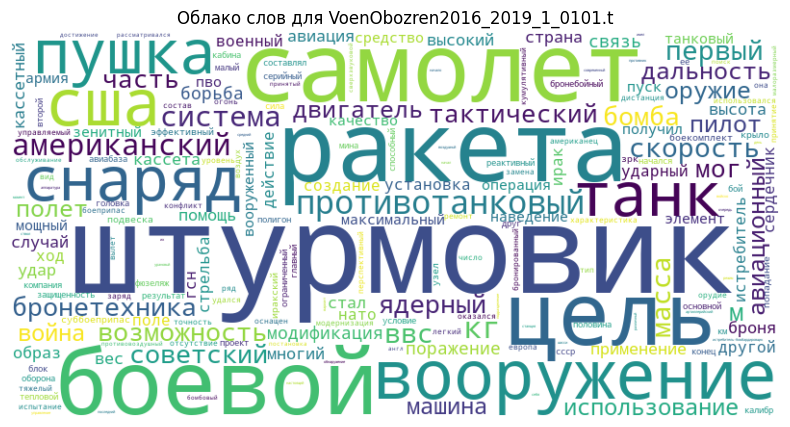

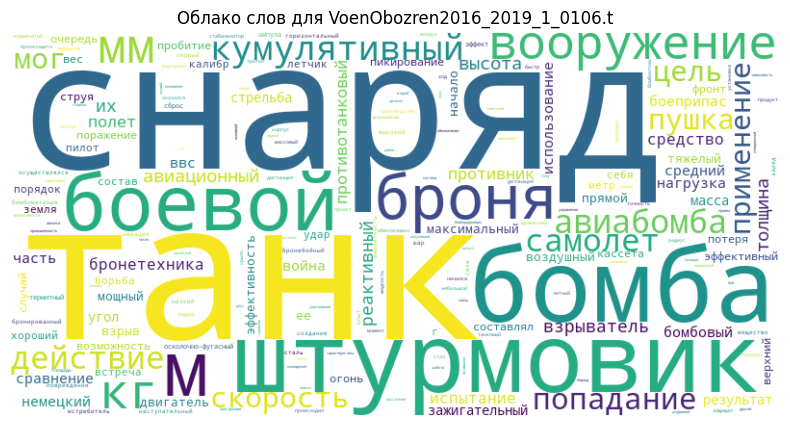

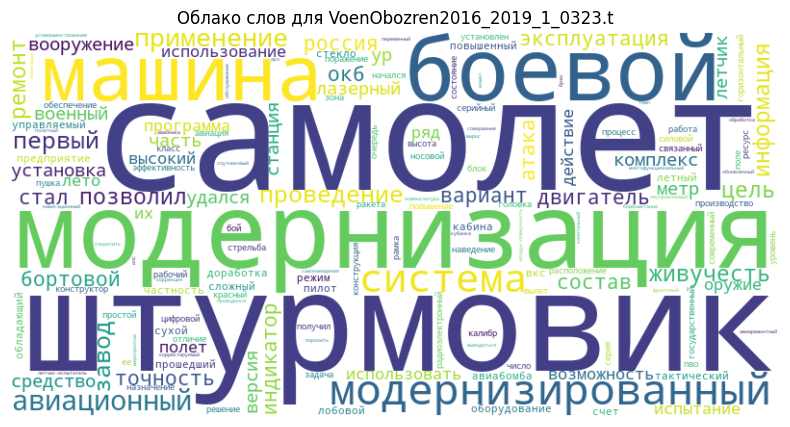

                          Document  Cluster
0    VoenObozren2016_2019_1_0001.t       -1
1    VoenObozren2016_2019_1_0002.t       -1
2    VoenObozren2016_2019_1_0003.t       -1
3    VoenObozren2016_2019_1_0004.t       -1
4    VoenObozren2016_2019_1_0005.t       -1
..                             ...      ...
358  VoenObozren2016_2019_1_0363.t       -1
359  VoenObozren2016_2019_1_0364.t       -1
360  VoenObozren2016_2019_1_0365.t        0
361  VoenObozren2016_2019_1_0366.t        0
362  VoenObozren2016_2019_1_0367.t        0

[363 rows x 2 columns]
    Cluster                   Central_File
0         0  VoenObozren2016_2019_1_0367.t
1         1  VoenObozren2016_2019_1_0062.t
2         2  VoenObozren2016_2019_1_0105.t
3         3  VoenObozren2016_2019_1_0141.t
4         4  VoenObozren2016_2019_1_0073.t
5         5  VoenObozren2016_2019_1_0095.t
6         6  VoenObozren2016_2019_1_0129.t
7         7  VoenObozren2016_2019_1_0213.t
8         8  VoenObozren2016_2019_1_0248.t
9         9  VoenO

In [11]:
visualize_clusters(dbscan_clusters['Cluster'].values, tfidf_matrix, "DBSCAN")
generate_word_cloud(5, dbscan_clusters, "DBSCAN")
print(dbscan_clusters)
print(dbscan_cluster_centers)
evaluate_clustering_quality(tfidf_matrix, dbscan_labels, "DBSCAN")

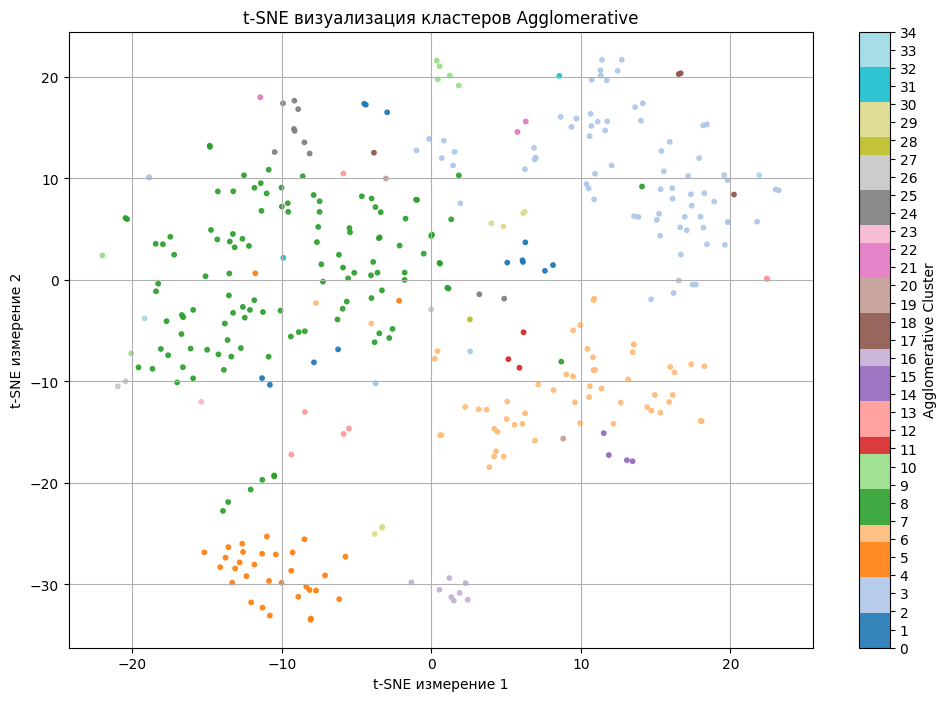

Agglomerative кластеры: {0: 7, 1: 6, 2: 69, 3: 10, 4: 31, 5: 2, 6: 56, 7: 6, 8: 112, 9: 5, 10: 2, 11: 3, 12: 5, 13: 2, 14: 3, 15: 1, 16: 8, 17: 2, 18: 2, 19: 1, 20: 1, 21: 2, 22: 1, 23: 1, 24: 8, 25: 2, 26: 2, 27: 1, 28: 1, 29: 3, 30: 4, 31: 1, 32: 1, 33: 1, 34: 1}
Файлы в кластере 11 (Agglomerative):
VoenObozren2016_2019_1_0009.t
VoenObozren2016_2019_1_0015.t
VoenObozren2016_2019_1_0147.t


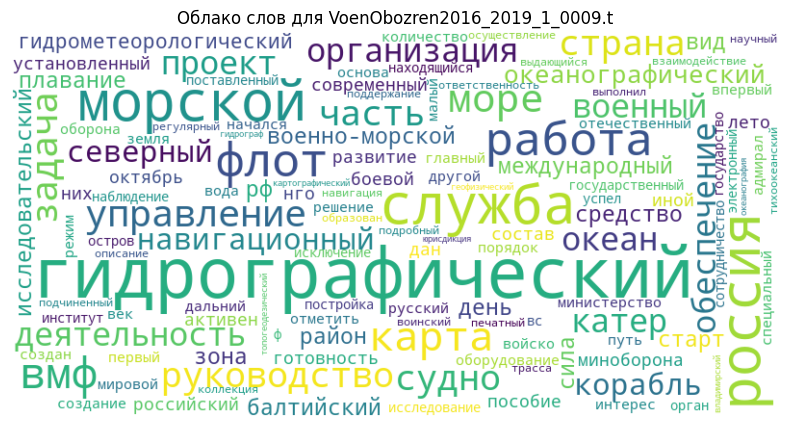

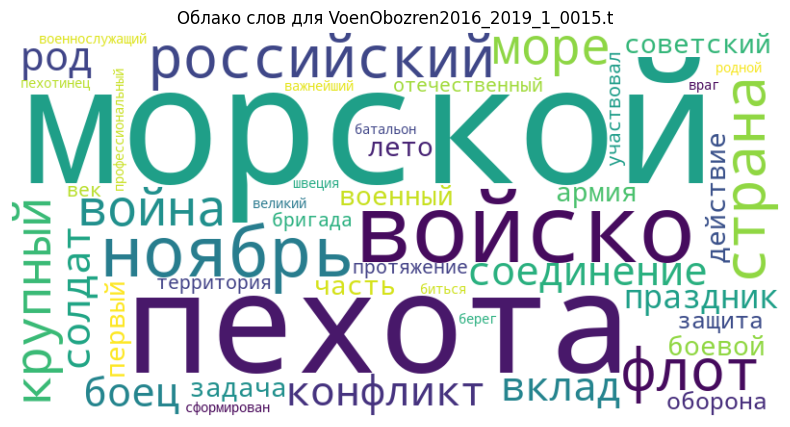

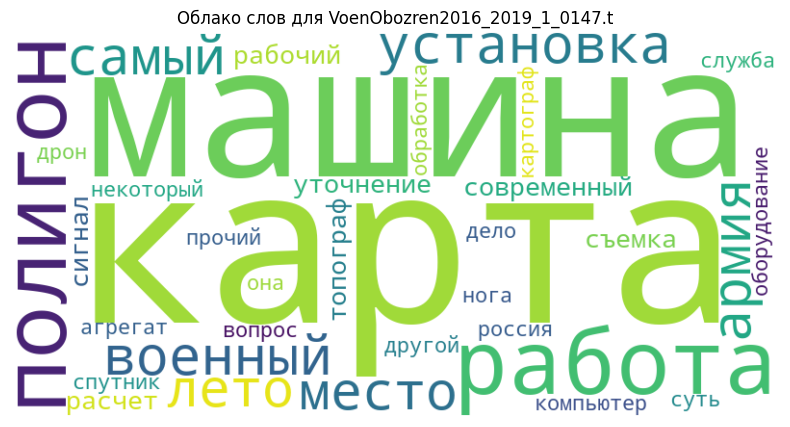

                          Document  Cluster
0    VoenObozren2016_2019_1_0001.t       29
1    VoenObozren2016_2019_1_0002.t       30
2    VoenObozren2016_2019_1_0003.t        6
3    VoenObozren2016_2019_1_0004.t        7
4    VoenObozren2016_2019_1_0005.t        8
..                             ...      ...
358  VoenObozren2016_2019_1_0363.t        6
359  VoenObozren2016_2019_1_0364.t        8
360  VoenObozren2016_2019_1_0365.t       16
361  VoenObozren2016_2019_1_0366.t       16
362  VoenObozren2016_2019_1_0367.t       16

[363 rows x 2 columns]
    Cluster                   Central_File
0         0  VoenObozren2016_2019_1_0020.t
1         1  VoenObozren2016_2019_1_0289.t
2         2  VoenObozren2016_2019_1_0292.t
3         3  VoenObozren2016_2019_1_0033.t
4         4  VoenObozren2016_2019_1_0222.t
5         5  VoenObozren2016_2019_1_0010.t
6         6  VoenObozren2016_2019_1_0073.t
7         7  VoenObozren2016_2019_1_0283.t
8         8  VoenObozren2016_2019_1_0067.t
9         9  VoenO

In [12]:
visualize_clusters(agglo_clusters['Cluster'].values, tfidf_matrix, "Agglomerative")
generate_word_cloud(11, agglo_clusters, "Agglomerative")
print(agglo_clusters)
print(agglo_cluster_centers)
evaluate_clustering_quality(tfidf_matrix, agglo_labels, "Agglomerative")


In [13]:
output_path = "..\\..\\data\\words\\dataprocessed_dataset.csv"
df.to_csv(output_path, index=False, encoding='windows-1251')
print(f"Данные успешно сохранены в {output_path}")

Данные успешно сохранены в ..\..\data\words\dataprocessed_dataset.csv


In [14]:
def get_doc_texts(dataframe, doc_index):
    texts = []
    for doc_name in doc_index:
        doc_words = dataframe[dataframe['DocumentName'] == doc_name]['NormalizedWord'].tolist()
        doc_text = " ".join(doc_words)
        texts.append(doc_text)
    return texts

doc_names = doc_word_matrix.index.tolist()
doc_texts = get_doc_texts(filtered_df, doc_names)

In [15]:
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')
model

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

SentenceTransformer(
  (0): Transformer({'max_seq_length': 256, 'do_lower_case': False}) with Transformer model: BertModel 
  (1): Pooling({'word_embedding_dimension': 384, 'pooling_mode_cls_token': False, 'pooling_mode_mean_tokens': True, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
  (2): Normalize()
)

In [16]:
embeddings = model.encode(doc_texts, show_progress_bar=True)
embeddings = np.array(embeddings)
embeddings

Batches:   0%|          | 0/12 [00:00<?, ?it/s]

array([[-0.01052514,  0.01019895, -0.03576716, ..., -0.01375329,
        -0.00153024, -0.02210907],
       [-0.00845698, -0.0017965 , -0.00358794, ..., -0.04242104,
        -0.01512554, -0.04490081],
       [-0.03609778,  0.00940195, -0.0098716 , ..., -0.01483949,
        -0.03534897, -0.02723767],
       ...,
       [-0.01747234, -0.01005614, -0.00890811, ...,  0.01560831,
        -0.0282917 , -0.05242353],
       [-0.00545264,  0.00040842, -0.00996102, ...,  0.03793934,
         0.01031251, -0.04782376],
       [-0.00492269, -0.00793833, -0.04113007, ...,  0.02386588,
        -0.02775128, -0.07470302]], dtype=float32)

In [17]:
k_nn = 20
kmeans_nn = KMeans(n_clusters=k_nn, random_state=42, n_init="auto")
kmeans_nn_labels = kmeans_nn.fit_predict(embeddings)

save_clusters(kmeans_nn_labels, "kmeans_nn")
save_cluster_centers(embeddings, kmeans_nn_labels, "kmeans_nn")

In [18]:
eps_nn = 0.5
min_samples_nn = 5
dbscan_nn = DBSCAN(eps=eps_nn, min_samples=min_samples_nn, metric='cosine')
dbscan_nn_labels = dbscan_nn.fit_predict(embeddings)

save_clusters(dbscan_nn_labels, "dbscan_nn")
save_cluster_centers(embeddings, dbscan_nn_labels, "dbscan_nn")

In [21]:
from sklearn.metrics.pairwise import cosine_distances

cosine_distance_matrix = cosine_distances(embeddings)

n_clusters_agglo_nn = 25
agglo_nn = AgglomerativeClustering(n_clusters=n_clusters_agglo_nn, metric='precomputed', linkage='average')
agglo_nn_labels = agglo_nn.fit_predict(cosine_distance_matrix)

save_clusters(agglo_nn_labels, "agglomerative_nn")
save_cluster_centers(embeddings, agglo_nn_labels, "agglomerative_nn")

In [22]:
evaluate_clustering_quality(embeddings, kmeans_nn_labels, "K-Means (Neural Embeddings)")
evaluate_clustering_quality(embeddings, dbscan_nn_labels, "DBSCAN (Neural Embeddings)")
evaluate_clustering_quality(embeddings, agglo_nn_labels, "Agglomerative (Neural Embeddings)")

Метрики качества для K-Means (Neural Embeddings):
  - Силуэтный коэффициент: 0.07153087109327316
  - Коэффициент Давиеса-Боулдина: 2.28436875370502
Метрики качества для DBSCAN (Neural Embeddings):
  - Силуэтный коэффициент: None
  - Коэффициент Давиеса-Боулдина: None
Метрики качества для Agglomerative (Neural Embeddings):
  - Силуэтный коэффициент: 0.15587833523750305
  - Коэффициент Давиеса-Боулдина: 0.7488749158970306


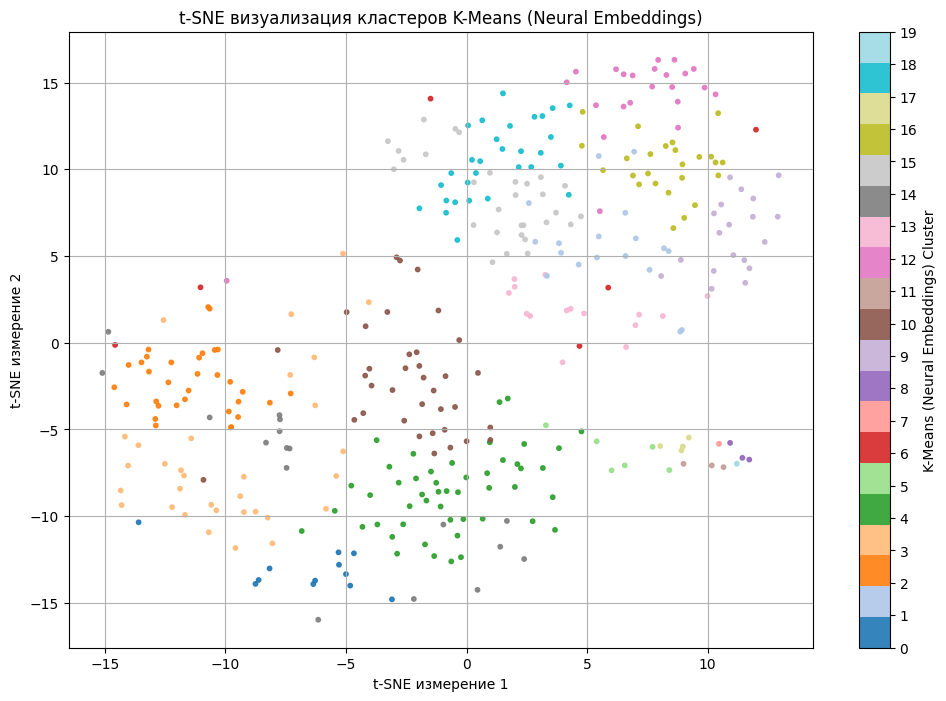

K-Means (Neural Embeddings) кластеры: {0: 12, 1: 18, 2: 33, 3: 32, 4: 49, 5: 6, 6: 6, 7: 1, 8: 3, 9: 19, 10: 36, 11: 3, 12: 23, 13: 15, 14: 17, 15: 30, 16: 25, 17: 4, 18: 30, 19: 1}


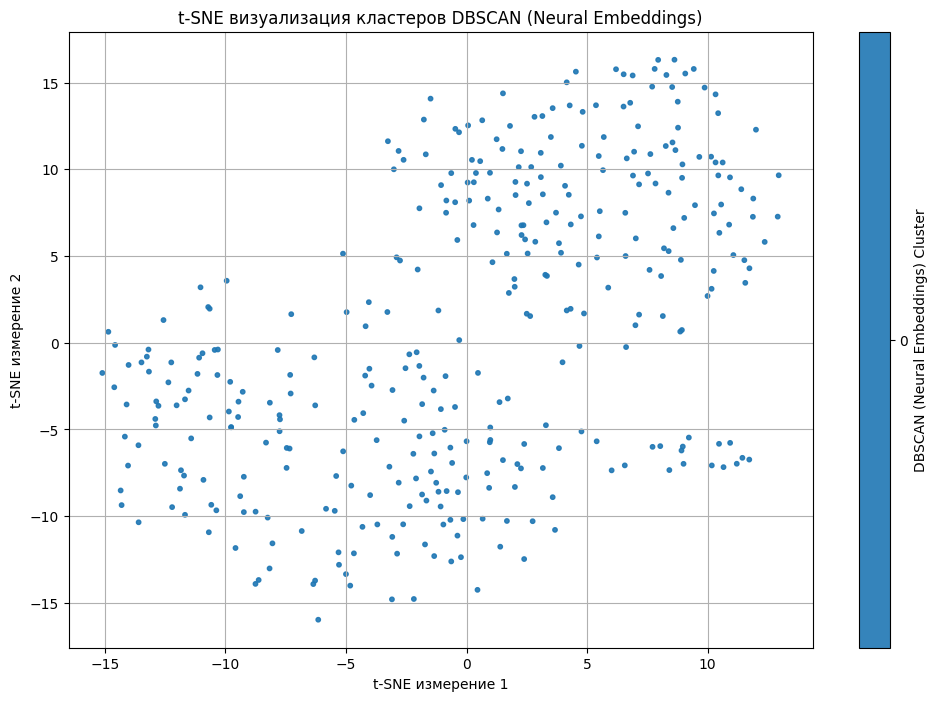

DBSCAN (Neural Embeddings) кластеры: {0: 363}


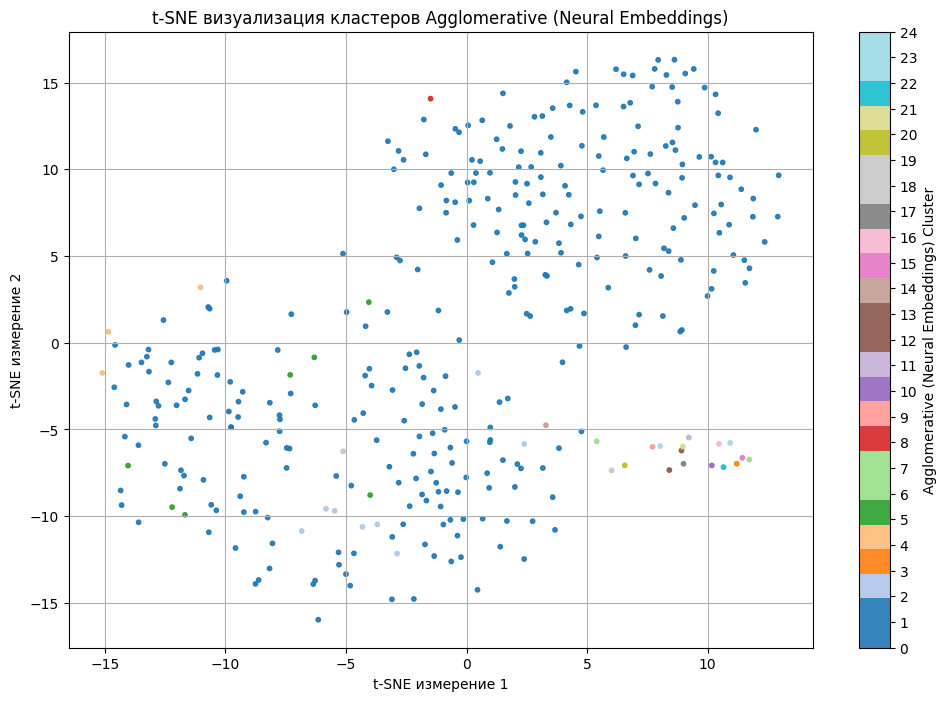

Agglomerative (Neural Embeddings) кластеры: {0: 3, 1: 322, 2: 8, 3: 1, 4: 3, 5: 7, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1, 14: 1, 15: 1, 16: 1, 17: 1, 18: 1, 19: 1, 20: 1, 21: 1, 22: 1, 23: 1, 24: 1}


In [27]:
visualize_clusters(kmeans_nn_labels, embeddings, "K-Means (Neural Embeddings)")
visualize_clusters(dbscan_nn_labels, embeddings, "DBSCAN (Neural Embeddings)")
visualize_clusters(agglo_nn_labels, embeddings, "Agglomerative (Neural Embeddings)")

In [35]:
kmeans_nn_clusters = load_clusters("..\\..\\data\\words\\kmeans_nn_clusters.csv")
dbscan_nn_clusters = load_clusters("..\\..\\data\\words\\dbscan_nn_clusters.csv")
agglo_nn_clusters = load_clusters("..\\..\\data\\words\\agglomerative_nn_clusters.csv")

Файлы в кластере 2 (K-Means (Neural Embeddings)):
VoenObozren2016_2019_1_0032.t
VoenObozren2016_2019_1_0037.t
VoenObozren2016_2019_1_0038.t
VoenObozren2016_2019_1_0045.t
VoenObozren2016_2019_1_0048.t
VoenObozren2016_2019_1_0062.t
VoenObozren2016_2019_1_0126.t
VoenObozren2016_2019_1_0127.t
VoenObozren2016_2019_1_0128.t
VoenObozren2016_2019_1_0130.t
VoenObozren2016_2019_1_0136.t
VoenObozren2016_2019_1_0148.t
VoenObozren2016_2019_1_0158.t
VoenObozren2016_2019_1_0159.t
VoenObozren2016_2019_1_0173.t
VoenObozren2016_2019_1_0182.t
VoenObozren2016_2019_1_0196.t
VoenObozren2016_2019_1_0197.t
VoenObozren2016_2019_1_0198.t
VoenObozren2016_2019_1_0207.t
VoenObozren2016_2019_1_0212.t
VoenObozren2016_2019_1_0246.t
VoenObozren2016_2019_1_0248.t
VoenObozren2016_2019_1_0278.t
VoenObozren2016_2019_1_0287.t
VoenObozren2016_2019_1_0290.t
VoenObozren2016_2019_1_0297.t
VoenObozren2016_2019_1_0304.t
VoenObozren2016_2019_1_0309.t
VoenObozren2016_2019_1_0326.t
VoenObozren2016_2019_1_0328.t
VoenObozren2016_2019

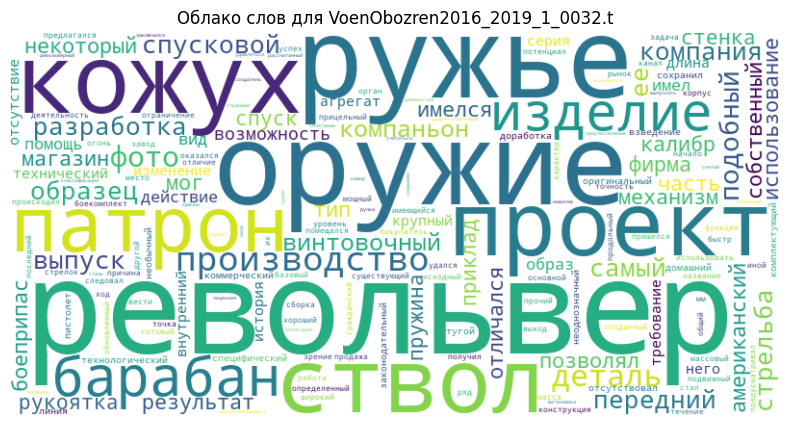

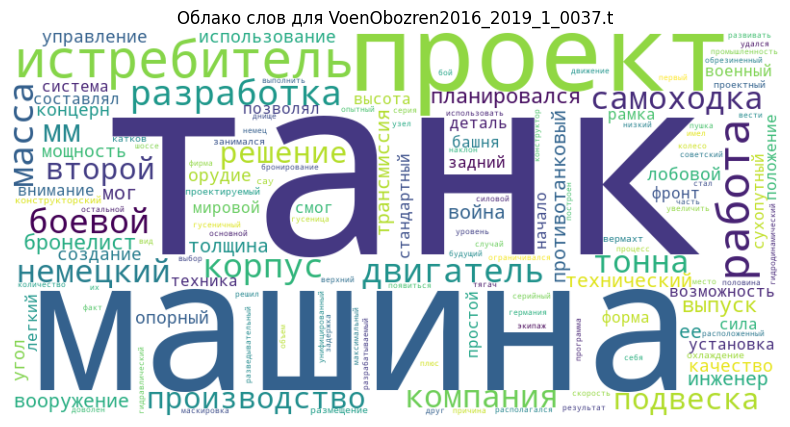

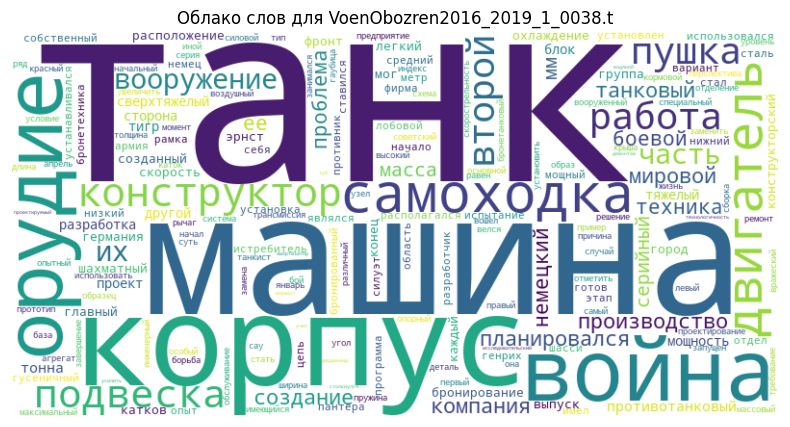

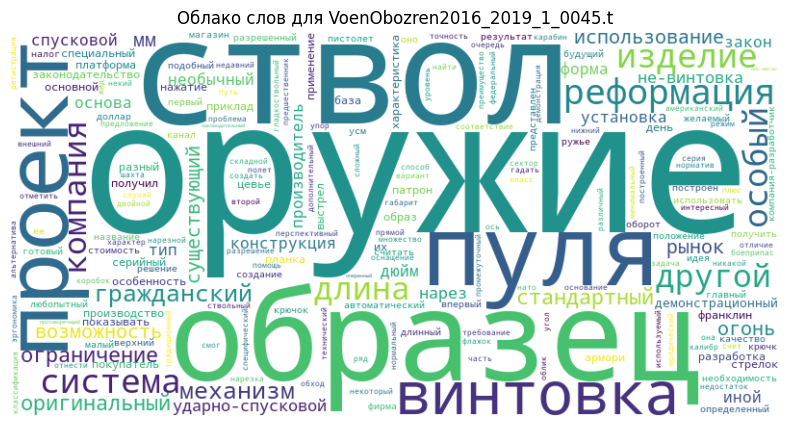

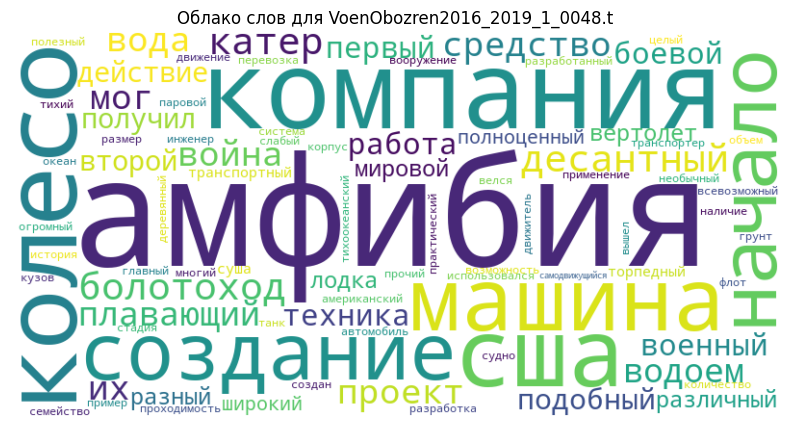

...

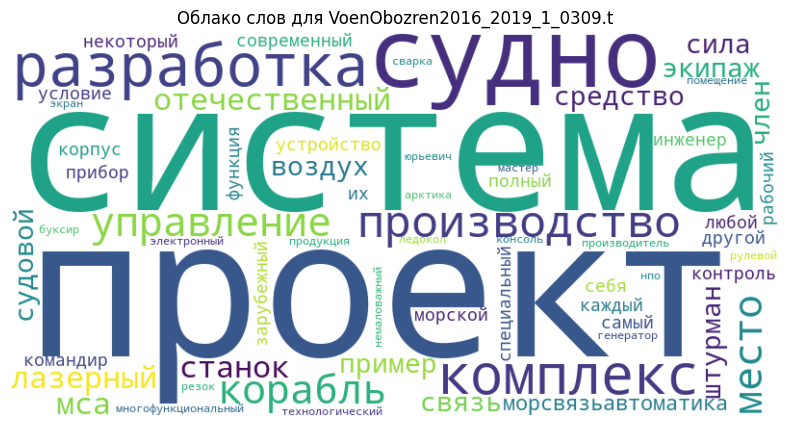

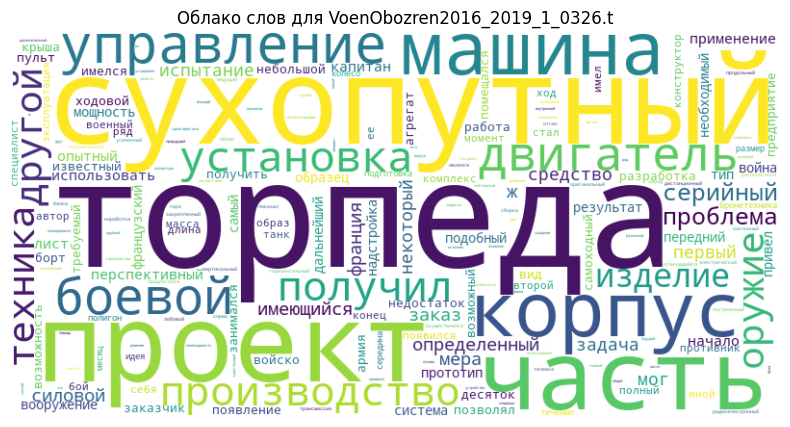

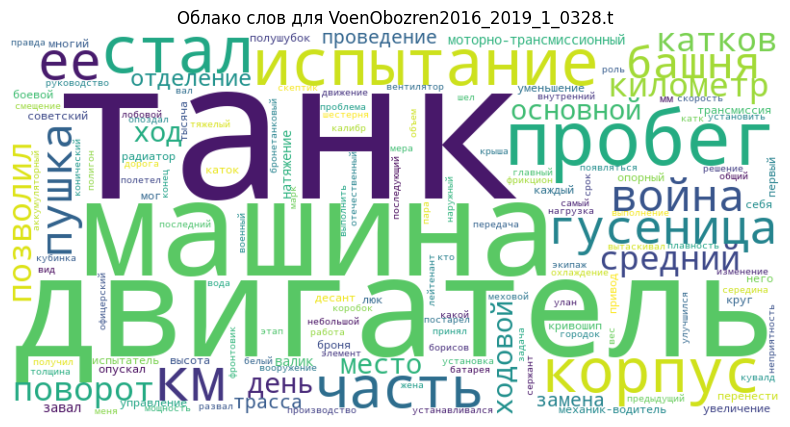

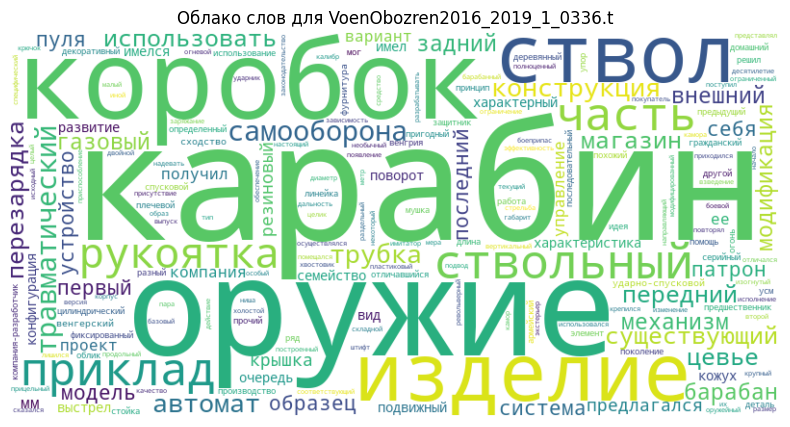

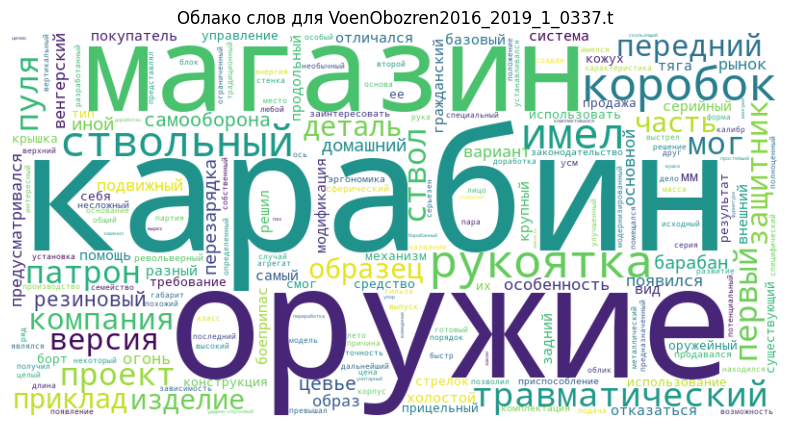

Файлы в кластере 2 (DBSCAN (Neural Embeddings)):
Файлы в кластере 2 (Agglomerative (Neural Embeddings)):
VoenObozren2016_2019_1_0005.t
VoenObozren2016_2019_1_0006.t
VoenObozren2016_2019_1_0015.t
VoenObozren2016_2019_1_0016.t
VoenObozren2016_2019_1_0019.t
VoenObozren2016_2019_1_0058.t
VoenObozren2016_2019_1_0150.t
VoenObozren2016_2019_1_0199.t


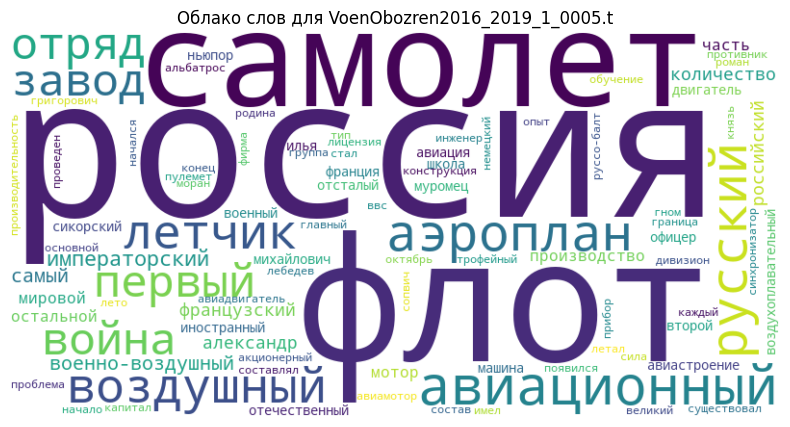

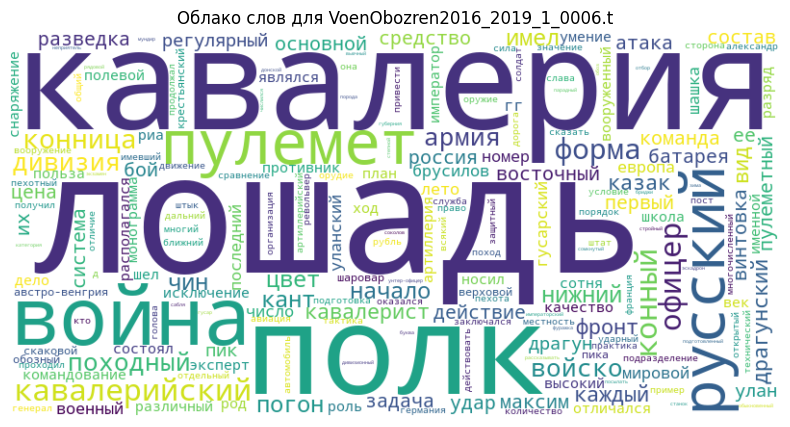

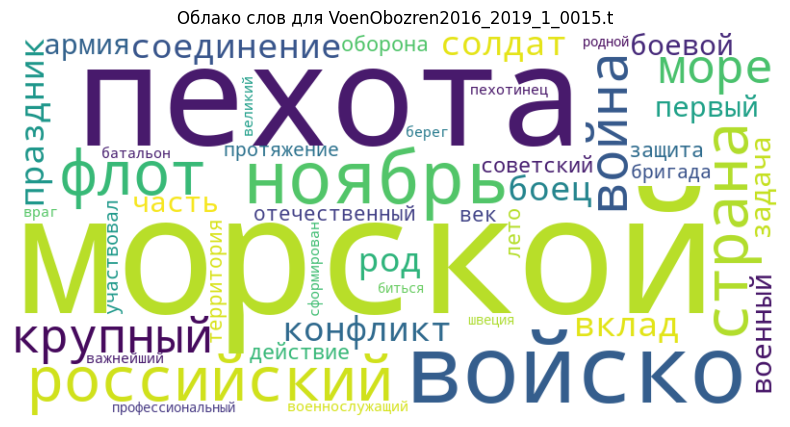

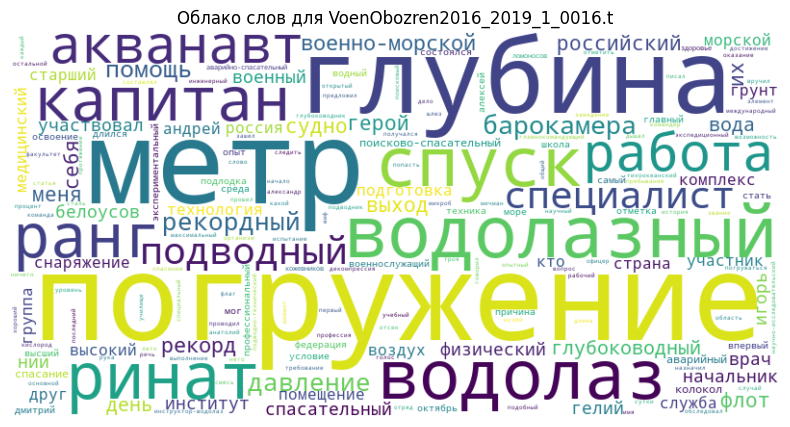

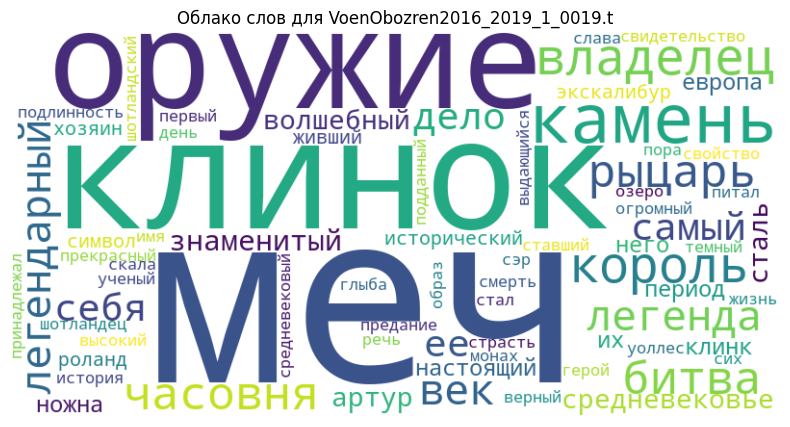

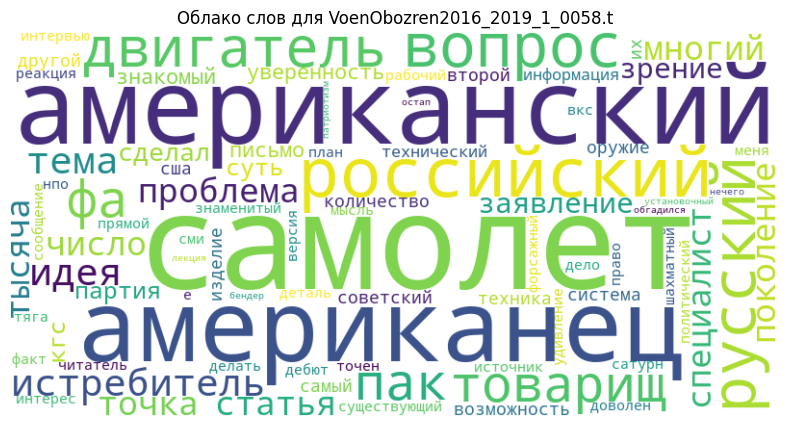

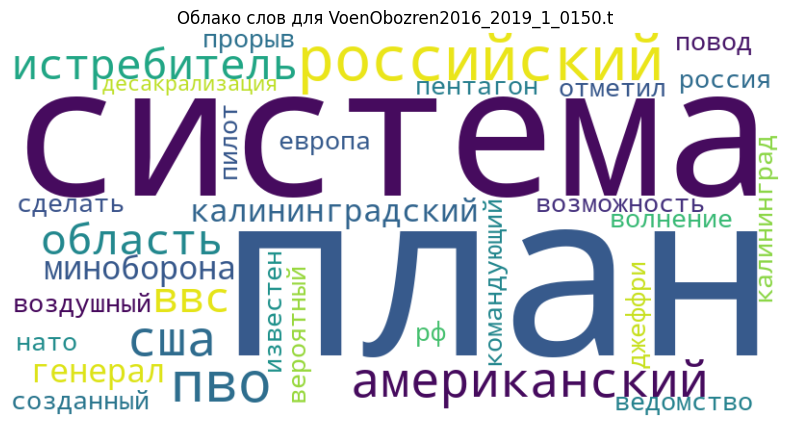

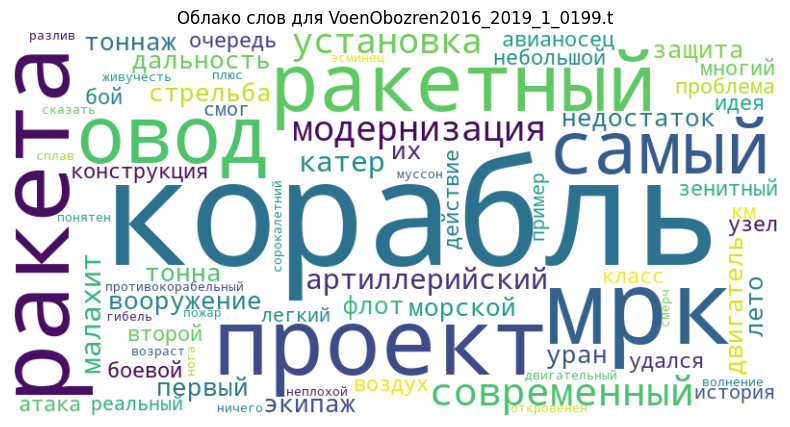

In [36]:
generate_word_cloud(2, kmeans_nn_clusters, "K-Means (Neural Embeddings)")
generate_word_cloud(2, dbscan_nn_clusters, "DBSCAN (Neural Embeddings)")
generate_word_cloud(2, agglo_nn_clusters, "Agglomerative (Neural Embeddings)")